In [1]:
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
import pickle

from emgdecompy.preprocessing import * 
from functions import *
from realtime_decomp import *

# Gastrocnemius medialis 10% MVC
gm_10 = loadmat('./data/experimental_data_raw/gm_10.mat')['SIG']

indpt_gm10_pnr = loadmat('./data/experimental_data_raw/gm_10.mat')['MUPulses']

ref_gm10_pnr = loadmat('./data/experimental_data_raw/gm_10.mat')['ref_signal']

with open('./data/decomp_gm10_x9_tmod.obj', 'rb') as f: decomp_gm10_x9_tmod = pickle.load(f)
with open('./data/decomp_gm10_x62_tmod.obj', 'rb') as f: decomp_gm10_x62_tmod = pickle.load(f)

In [2]:
data = gm_10
signal = "gm_10"
ref_signal = ref_gm10_pnr
batch_size = 4.0
noise_start = 0.0
noise_end = 3.0
ol=[1.0, 2.0, 3.0]

bad_ch = bad_channels(data, signal=signal, thd_snr=2.0, 
                      noise_start=noise_start, noise_end=noise_end, fs=2048)
snr = calc_snr(data, 
               noise_start=noise_start, noise_end=noise_end, fs=2048)

disc_ch = loadmat('./data/experimental_data_raw/gm_10.mat')['discardChannelsVec']


disc_ch_flat = discard_ch_flat(disc_ch, gm_10)
print(disc_ch_flat)
print(np.argwhere(disc_ch_flat == 1))


Bad channels in gm_10: [9]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
[[62]]


# a. Training Module
## i. Decomposition

In [3]:
decomp = decomp_gm10_x9_tmod

In [4]:
decomp_gm10_x62_tmod = decomposition_tmod(x=data,
                            discard=disc_ch_flat,
                            R=16,
                            M=64,
                            bandpass=True,
                            lowcut=10,
                            highcut = 900,
                            fs=2048,
                            order=6,
                            Tolx=10e-4,
                            contrast_fun=skew,
                            ortho_fun=gram_schmidt,
                            max_iter_sep=10,
                            l=31,
                            sil_pnr=True,
                            thresh=0.9,
                            max_iter_ref=10,
                            random_seed=None,
                            verbose=False)

Centred.
Extended.
Whitened.
Extracted source at iteration 0.
Extracted source at iteration 1.
Extracted source at iteration 4.
Extracted source at iteration 5.
Extracted source at iteration 7.
Extracted source at iteration 8.
Extracted source at iteration 10.
Extracted source at iteration 11.
Extracted source at iteration 12.
Extracted source at iteration 13.
Extracted source at iteration 14.
Extracted source at iteration 15.
Extracted source at iteration 16.
Extracted source at iteration 17.
Extracted source at iteration 18.
Extracted source at iteration 19.
Extracted source at iteration 20.
Extracted source at iteration 21.
Extracted source at iteration 22.
Extracted source at iteration 23.
Extracted source at iteration 24.
Extracted source at iteration 27.
Extracted source at iteration 28.
Extracted source at iteration 31.
Extracted source at iteration 32.
Extracted source at iteration 33.
Extracted source at iteration 35.
Extracted source at iteration 37.
Extracted source at itera

In [27]:
decomp_sample = decomp_gm10_x62_tmod 
decomp_sample_pkl = open('decomp_gm10_x62_tmod.obj', 'wb') 
pickle.dump(decomp_sample, decomp_sample_pkl)

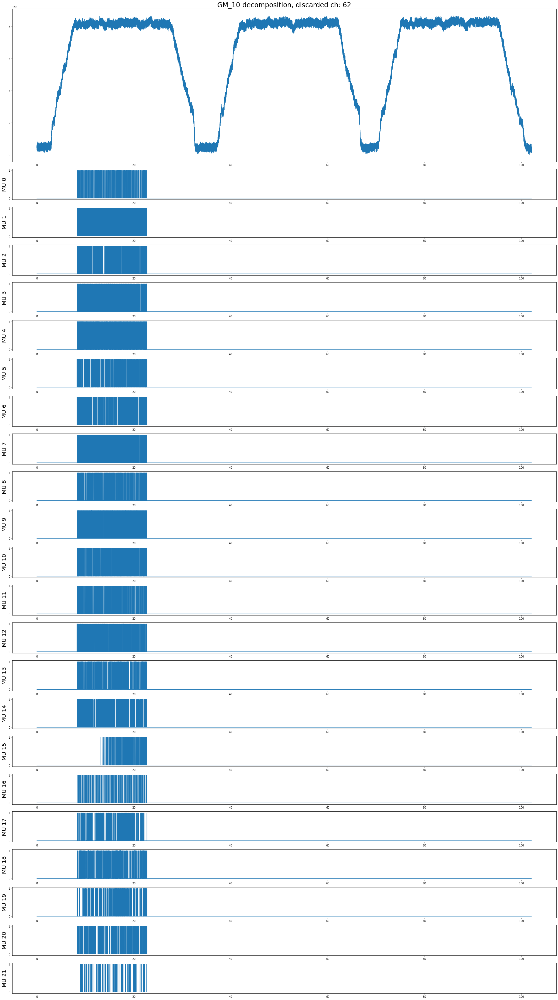

In [7]:
visualize_pt(indpt_gm10_pnr, 
             data, ref_signal=ref_signal, title="GM_10 decomposition, discarded ch: 62")

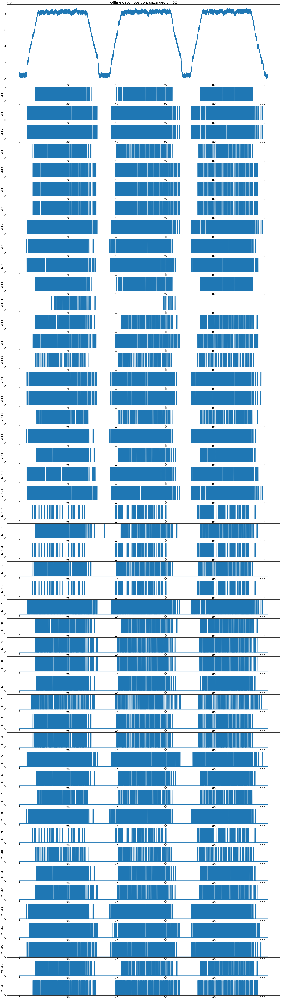

In [8]:
visualize_pt(decomp_gm10_x62_tmod["MUPulses"], 
             data, ref_signal=ref_signal, title="Offline decomposition, discarded ch: 62")

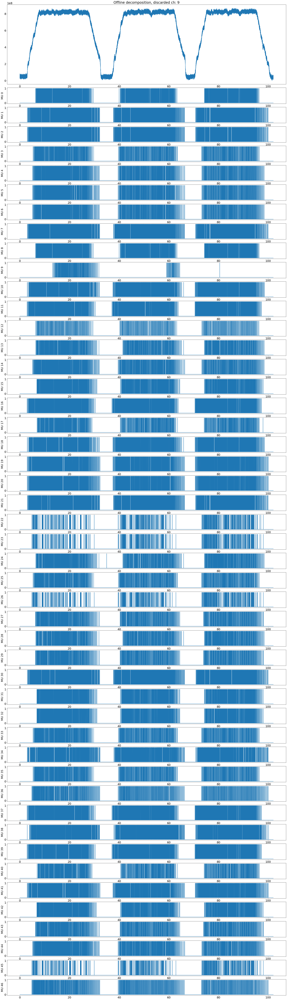

In [9]:
visualize_pt(decomp_gm10_x9_tmod["MUPulses"], 
             data, ref_signal=ref_signal, title="Offline decomposition, discarded ch: 9")

## ii. Separation matrix

In [4]:
decomp = decomp_gm10_x62_tmod
bad_ch = disc_ch_flat

# Realtime separation matrix
B = decomp["B"]
B_rt, mean_tm = sep_realtime(data, B, discard=bad_ch)

# Signal and noise centroids
signal_centroids_tm = decomp["peak_centroids"]
noise_centroids_tm = decomp["noise_centroids"]

# s^2 from the offline decomposition
s2_tm = np.square(decomp["s"])

# normalized signal and noise centroids (centroid / max(s^2))
sc_tm = []
nc_tm = []
for i in range(signal_centroids_tm.size):
    sc_tm.append(signal_centroids_tm[i] / signal_centroids_tm.max())
    nc_tm.append(noise_centroids_tm[i] / signal_centroids_tm.max())
sc_tm = np.array(sc_tm)
nc_tm = np.array(nc_tm)

# b. Decomposition module
## i. `kmeans_sil_cp`
### 4.0s, no overlap

In [5]:
kmeans_sil_cp_40 = batch_decomp(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.85, 
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=0.0)

In [6]:
roa_kmeans_sil_cp_40 = calc_roa(ind_pt1=kmeans_sil_cp_40["MUPulses"], 
                                ind_pt2=decomp["MUPulses"], 
                                data=data, 
                                decomp=f"kmeans_sil_cp {batch_size}s")

RoA between offline decomposition and kmeans_sil_cp 4.0s (%):
Motor unit 0: 51.661307609860664
Motor unit 1: 10.759844703272323
Motor unit 2: 16.385135135135137
Motor unit 3: 39.87240829346093
Motor unit 4: 64.88340192043896
Motor unit 5: 87.33431516936672
Motor unit 6: 71.14093959731544
Motor unit 7: 2.8081123244929795
Motor unit 8: 53.085210577864835
Motor unit 9: 41.62479061976549
Motor unit 10: 67.17752234993614
Motor unit 11: 2.9715762273901807
Motor unit 12: 1.8203883495145632
Motor unit 13: 62.89473684210526
Motor unit 14: 79.7071129707113
Motor unit 15: 12.881144990665836
Motor unit 16: 52.426160337552744
Motor unit 17: 20.18018018018018
Motor unit 18: 49.952516619183285
Motor unit 19: 5.30093870789619
Motor unit 20: 33.16790736145575
Motor unit 21: 5.357142857142857
Motor unit 22: 18.796992481203006
Motor unit 23: 31.019522776572668
Motor unit 24: 40.03690036900369
Motor unit 25: 44.64831804281346
Motor unit 26: 16.90885072655218
Motor unit 27: 7.131367292225201
Motor unit 28:

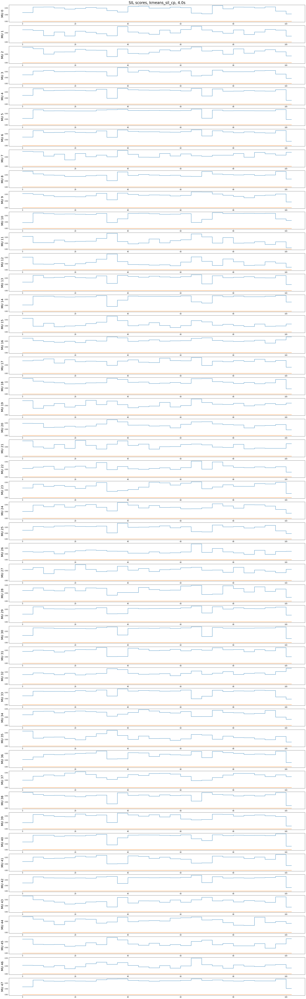

In [7]:
plot_sil(kmeans_sil_cp_40["sil_scores"], thd_sil=0.85,
         title=f"SIL scores, kmeans_sil_cp, {batch_size}s")

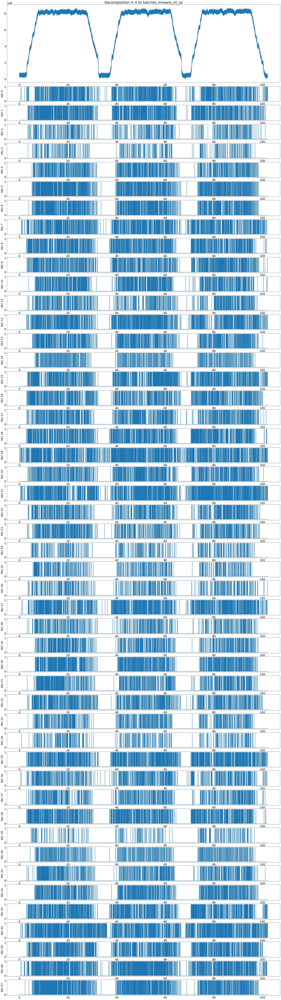

In [8]:
visualize_pt(kmeans_sil_cp_40["MUPulses"], 
             data, ref_signal = ref_signal,
             title=f"Decomposition in {batch_size}s batches, kmeans_sil_cp")

In [53]:
kmeans_sil09_cp_40 = batch_decomp(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.9, 
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=0.0)

In [54]:
roa_kmeans_sil09_cp_40 = calc_roa(ind_pt1=kmeans_sil09_cp_40["MUPulses"], 
                                ind_pt2=decomp["MUPulses"], 
                                data=data, 
                                decomp=f"kmeans_sil09_cp {batch_size}s")

RoA between offline decomposition and kmeans_sil09_cp 4.0s (%):
Motor unit 0: 51.768488745980704
Motor unit 1: 8.584005869405722
Motor unit 2: 16.342082980524978
Motor unit 3: 40.03189792663477
Motor unit 4: 64.88340192043896
Motor unit 5: 87.33431516936672
Motor unit 6: 71.14093959731544
Motor unit 7: 2.460984393757503
Motor unit 8: 53.13725490196079
Motor unit 9: 41.645675902602854
Motor unit 10: 67.26342710997443
Motor unit 11: 3.2763532763532766
Motor unit 12: 0.631578947368421
Motor unit 13: 63.06068601583114
Motor unit 14: 79.7071129707113
Motor unit 15: 10.550814584949574
Motor unit 16: 52.426160337552744
Motor unit 17: 20.40072859744991
Motor unit 18: 50.238777459407835
Motor unit 19: 4.311008468052348
Motor unit 20: 33.16790736145575
Motor unit 21: 3.586800573888092
Motor unit 22: 17.51412429378531
Motor unit 23: 31.450719822812847
Motor unit 24: 39.66789667896679
Motor unit 25: 44.64831804281346
Motor unit 26: 15.988779803646564
Motor unit 27: 6.296048225050234
Motor unit 28:

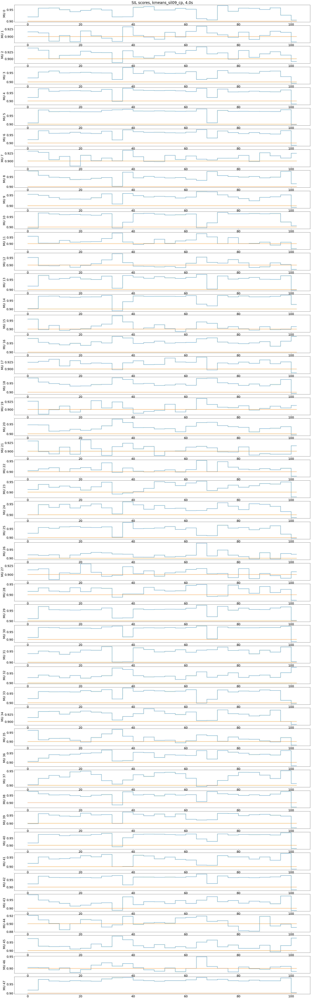

In [55]:
plot_sil(kmeans_sil09_cp_40["sil_scores"], thd_sil=0.9,
         title=f"SIL scores, kmeans_sil09_cp, {batch_size}s")

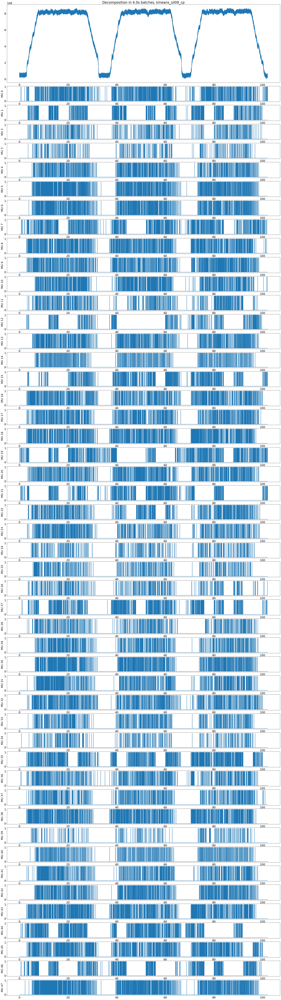

In [56]:
visualize_pt(kmeans_sil09_cp_40["MUPulses"], 
             data, ref_signal = ref_signal,
             title=f"Decomposition in {batch_size}s batches, kmeans_sil09_cp")

### 4.0s, 1.0s overlap

In [9]:
kmeans_sil_cp_40_ol10 = batch_decomp(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.85, 
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=ol[0])

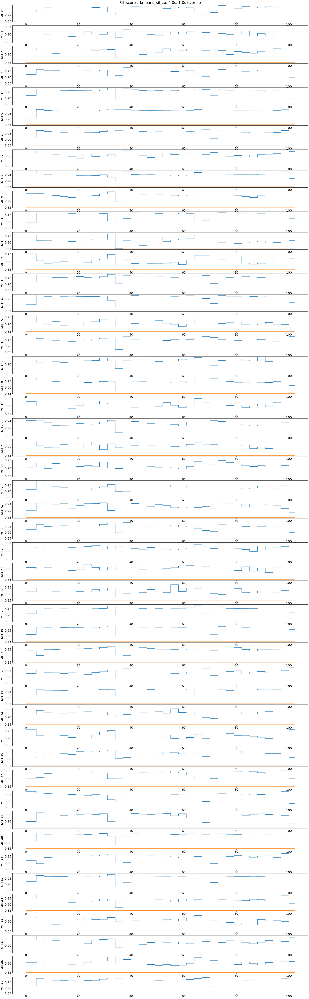

In [10]:
plot_sil(kmeans_sil_cp_40_ol10["sil_scores"], thd_sil=0.85,
         title=f"SIL scores, kmeans_sil_cp, {batch_size}s, {ol[0]}s overlap")

In [11]:
roa_kmeans_sil_cp_40_ol10 = calc_roa(ind_pt1=kmeans_sil_cp_40_ol10["MUPulses"], 
                                    ind_pt2=decomp["MUPulses"], 
                                    data=data, 
                                    decomp=f"kmeans_sil_cp {batch_size}s, overlap:{ol[0]}s")

RoA between offline decomposition and kmeans_sil_cp 4.0s, overlap:1.0s (%):
Motor unit 0: 47.9
Motor unit 1: 10.905125408942203
Motor unit 2: 15.648535564853557
Motor unit 3: 39.325842696629216
Motor unit 4: 65.20547945205479
Motor unit 5: 88.29629629629629
Motor unit 6: 70.46979865771812
Motor unit 7: 2.825428859737639
Motor unit 8: 53.00970873786408
Motor unit 9: 41.791044776119406
Motor unit 10: 65.92317224287484
Motor unit 11: 2.7166882276843465
Motor unit 12: 1.7261904761904763
Motor unit 13: 64.14342629482071
Motor unit 14: 80.66528066528066
Motor unit 15: 13.022410660205935
Motor unit 16: 52.103559870550164
Motor unit 17: 19.758412424503884
Motor unit 18: 49.717514124293785
Motor unit 19: 5.456570155902004
Motor unit 20: 32.57328990228013
Motor unit 21: 5.571428571428571
Motor unit 22: 18.317358892438765
Motor unit 23: 29.85884907709012
Motor unit 24: 40.515653775322285
Motor unit 25: 43.373493975903614
Motor unit 26: 16.556291390728475
Motor unit 27: 7.328015952143569
Motor uni

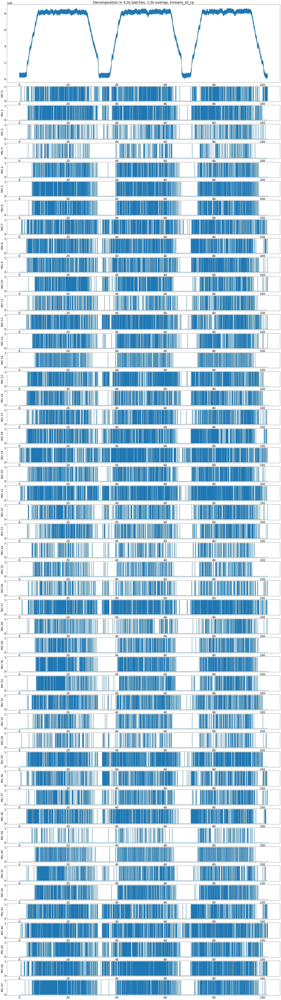

In [12]:
visualize_pt(kmeans_sil_cp_40_ol10["MUPulses"], 
             data, ref_signal=ref_signal,
             title=f"Decomposition in {batch_size}s batches, {ol[0]}s overlap, kmeans_sil_cp")

### 4.0s, 2.0s overlap

In [13]:
kmeans_sil_cp_40_ol20 = batch_decomp(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.85, 
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=ol[1])

In [14]:
roa_kmeans_sil_cp_40_ol20 = calc_roa(ind_pt1=kmeans_sil_cp_40_ol20["MUPulses"], 
                                    ind_pt2=decomp["MUPulses"], 
                                    data=data, 
                                    decomp=f"kmeans_sil_cp {batch_size}s, overlap:{ol[1]}s")

RoA between offline decomposition and kmeans_sil_cp 4.0s, overlap:2.0s (%):
Motor unit 0: 48.8517745302714
Motor unit 1: 10.898138006571742
Motor unit 2: 16.05351170568562
Motor unit 3: 39.61965134706814
Motor unit 4: 64.92434662998625
Motor unit 5: 87.74002954209749
Motor unit 6: 70.75471698113208
Motor unit 7: 2.7921406411582215
Motor unit 8: 54.091816367265466
Motor unit 9: 42.26890756302521
Motor unit 10: 67.00636942675159
Motor unit 11: 2.7603513174404015
Motor unit 12: 1.7406962785114046
Motor unit 13: 64.50331125827815
Motor unit 14: 80.49792531120332
Motor unit 15: 12.67519804996953
Motor unit 16: 51.59574468085106
Motor unit 17: 20.017559262510975
Motor unit 18: 50.816522574447646
Motor unit 19: 5.260273972602739
Motor unit 20: 32.97697368421053
Motor unit 21: 5.520581113801453
Motor unit 22: 19.169329073482427
Motor unit 23: 31.049250535331907
Motor unit 24: 41.32841328413284
Motor unit 25: 44.78063540090771
Motor unit 26: 17.30013106159895
Motor unit 27: 7.3145245559038665
M

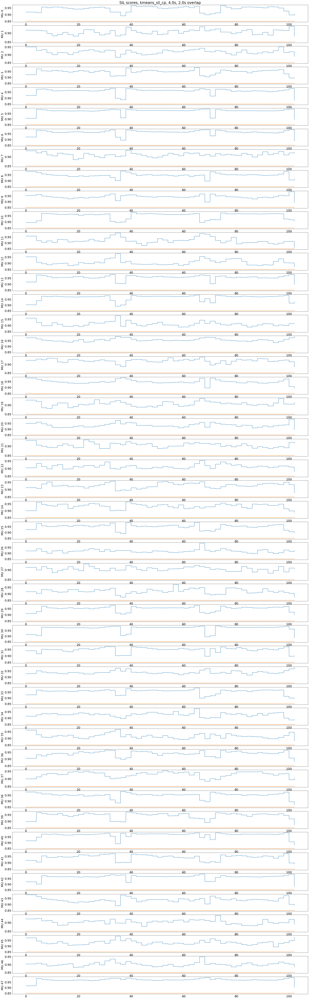

In [15]:
plot_sil(kmeans_sil_cp_40_ol20["sil_scores"], thd_sil=0.85,
         title=f"SIL scores, kmeans_sil_cp, {batch_size}s, {ol[1]}s overlap")

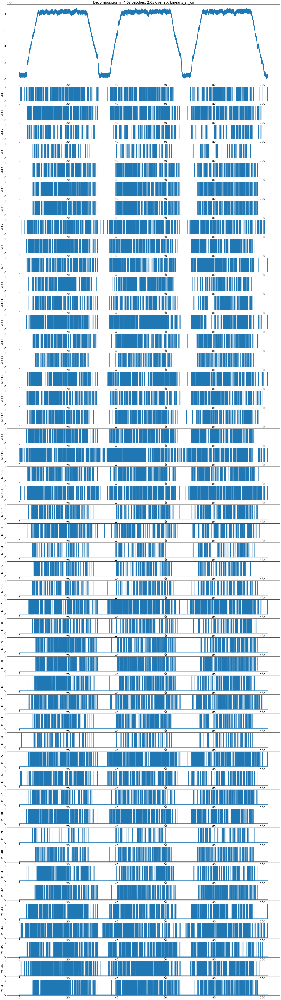

In [16]:
visualize_pt(kmeans_sil_cp_40_ol20["MUPulses"], 
             data, ref_signal=ref_signal,
             title=f"Decomposition in {batch_size}s batches, {ol[1]}s overlap, kmeans_sil_cp")

### 4.0s, 3.0s overlap

In [17]:
kmeans_sil_cp_40_ol30 = batch_decomp(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.85, 
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=ol[2])

In [18]:
roa_kmeans_sil_cp_40_ol30 = calc_roa(ind_pt1=kmeans_sil_cp_40_ol30["MUPulses"], 
                                    ind_pt2=decomp["MUPulses"], 
                                    data=data, 
                                    decomp=f"kmeans_sil_cp {batch_size}s, overlap:{ol[2]}s")

RoA between offline decomposition and kmeans_sil_cp 4.0s, overlap:3.0s (%):
Motor unit 0: 46.94082246740221
Motor unit 1: 10.753275109170305
Motor unit 2: 15.619834710743802
Motor unit 3: 38.765822784810126
Motor unit 4: 64.93150684931507
Motor unit 5: 87.8877400295421
Motor unit 6: 70.65948855989232
Motor unit 7: 2.7749747729566097
Motor unit 8: 54.69223007063572
Motor unit 9: 42.524916943521596
Motor unit 10: 66.125
Motor unit 11: 2.9484029484029484
Motor unit 12: 1.7643710870802505
Motor unit 13: 65.03311258278146
Motor unit 14: 80.16528925619835
Motor unit 15: 12.716417910447761
Motor unit 16: 52.12314225053078
Motor unit 17: 19.758412424503884
Motor unit 18: 51.34357005758157
Motor unit 19: 5.294759825327511
Motor unit 20: 32.40360951599672
Motor unit 21: 5.499760879961741
Motor unit 22: 18.35245046923879
Motor unit 23: 31.364124597207304
Motor unit 24: 39.355992844364934
Motor unit 25: 44.71299093655589
Motor unit 26: 16.964285714285715
Motor unit 27: 7.358201328564129
Motor unit

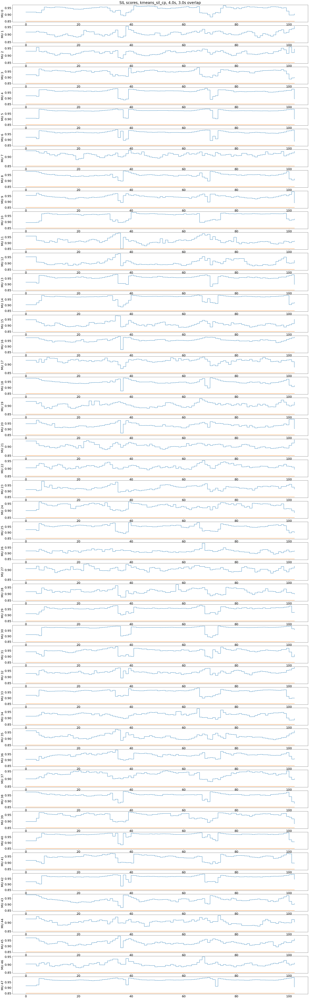

In [19]:
plot_sil(kmeans_sil_cp_40_ol30["sil_scores"], thd_sil=0.85,
         title=f"SIL scores, kmeans_sil_cp, {batch_size}s, {ol[2]}s overlap")

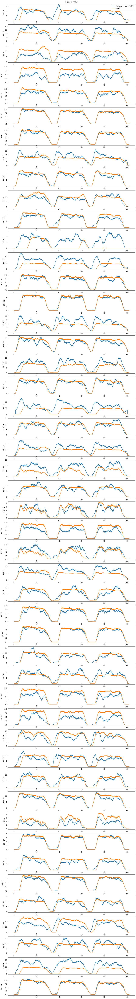

In [20]:
compare_firing_rate(ind_pt1=kmeans_sil_cp_40_ol30["MUPulses"], 
                    ind_pt2=decomp["MUPulses"],
                    data=data, time_bin=3.0, filt=False,
                    title="Firing rate",
                    label1="kmeans_sil_cp_40_ol30",
                    label2="Offline")

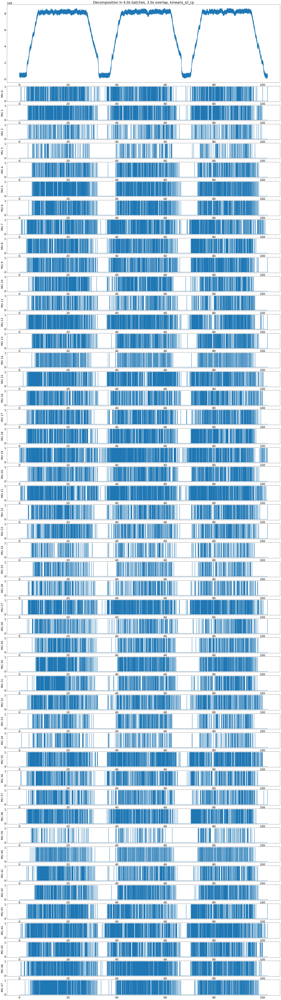

In [21]:
visualize_pt(kmeans_sil_cp_40_ol30["MUPulses"], 
             data, ref_signal=ref_signal,
             title=f"Decomposition in {batch_size}s batches, {ol[2]}s overlap, kmeans_sil_cp")

## ii. `kmeans_cp_window`
### 4.0s, no overlap

In [22]:
kmeans_sil_cp_window_40 = batch_decomp_window(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.85, 
                                     thd_pps=5,
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=0.0)

In [23]:
roa_kmeans_sil_cp_window_40 = calc_roa(ind_pt1=kmeans_sil_cp_window_40["MUPulses"], 
                                ind_pt2=decomp["MUPulses"], 
                                data=data, 
                                decomp=f"kmeans_cp_window {batch_size}s")

RoA between offline decomposition and kmeans_cp_window 4.0s (%):
Motor unit 0: 54.65253239104829
Motor unit 1: 10.3954802259887
Motor unit 2: 12.37842617152962
Motor unit 3: 11.336717428087987
Motor unit 4: 56.388888888888886
Motor unit 5: 83.89955686853767
Motor unit 6: 66.08108108108108
Motor unit 7: 2.8146574614976103
Motor unit 8: 51.28968253968254
Motor unit 9: 39.880444064901795
Motor unit 10: 64.58885941644563
Motor unit 11: 3.2763532763532766
Motor unit 12: 1.8856065367693275
Motor unit 13: 57.506702412868634
Motor unit 14: 71.3375796178344
Motor unit 15: 12.4282982791587
Motor unit 16: 48.88178913738019
Motor unit 17: 20.77431539187913
Motor unit 18: 48.31243972999036
Motor unit 19: 5.372132064913263
Motor unit 20: 30.930427493713328
Motor unit 21: 5.205751115518096
Motor unit 22: 19.372900335946248
Motor unit 23: 29.6
Motor unit 24: 23.142250530785564
Motor unit 25: 29.699842022116904
Motor unit 26: 15.064562410329986
Motor unit 27: 7.131192161132281
Motor unit 28: 19.4139194

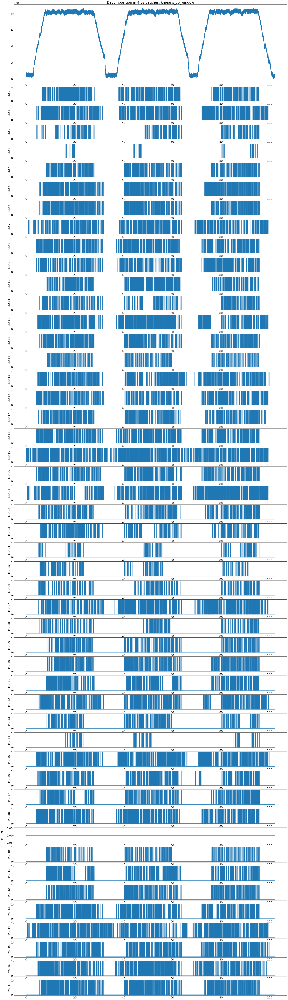

In [24]:
visualize_pt(kmeans_sil_cp_window_40["MUPulses"], 
             data, ref_signal=ref_signal,
             title=f"Decomposition in {batch_size}s batches, kmeans_cp_window")

### 4.0s, 1.0s overlap

In [25]:
kmeans_sil_cp_window_40_ol10 = batch_decomp_window(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.85, 
                                     thd_pps=5,
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=ol[0])

In [26]:
roa_kmeans_sil_cp_window_40_ol10 = calc_roa(ind_pt1=kmeans_sil_cp_window_40_ol10["MUPulses"], 
                                ind_pt2=decomp["MUPulses"], 
                                data=data, 
                                decomp=f"kmeans_cp_window {batch_size}s, overlap:{ol[0]}s")

RoA between offline decomposition and kmeans_cp_window 4.0s, overlap:1.0s (%):
Motor unit 0: 46.82203389830509
Motor unit 1: 10.422380691168403
Motor unit 2: 11.900532859680284
Motor unit 3: 8.843537414965986
Motor unit 4: 59.310344827586206
Motor unit 5: 82.37037037037037
Motor unit 6: 64.67391304347827
Motor unit 7: 2.8426395939086295
Motor unit 8: 53.273809523809526
Motor unit 9: 41.08658743633277
Motor unit 10: 64.78149100257069
Motor unit 11: 2.745664739884393
Motor unit 12: 1.7139479905437351
Motor unit 13: 59.375
Motor unit 14: 69.85138004246285
Motor unit 15: 12.561274509803921
Motor unit 16: 48.08743169398907
Motor unit 17: 20.552995391705068
Motor unit 18: 49.61832061068702
Motor unit 19: 5.499438832772166
Motor unit 20: 31.023102310231025
Motor unit 21: 5.5820610687022905
Motor unit 22: 18.161925601750546
Motor unit 23: 27.59022118742724
Motor unit 24: 24.329896907216494
Motor unit 25: 32.96875
Motor unit 26: 14.511494252873563
Motor unit 27: 7.178714859437751
Motor unit 28:

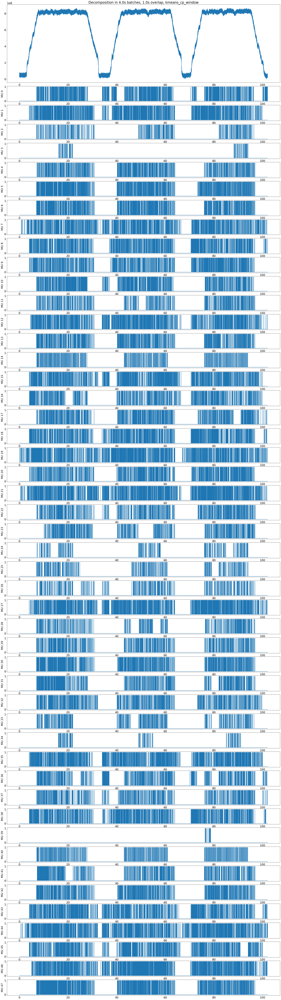

In [27]:
visualize_pt(kmeans_sil_cp_window_40_ol10["MUPulses"], 
             data, ref_signal=ref_signal,
             title=f"Decomposition in {batch_size}s batches, {ol[0]}s overlap, kmeans_cp_window")

### 4.0s, 2.0s overlap

In [28]:
kmeans_sil_cp_window_40_ol20 = batch_decomp_window(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.85, 
                                     thd_pps=5,
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=ol[1])

In [29]:
roa_kmeans_sil_cp_window_40_ol20 = calc_roa(ind_pt1=kmeans_sil_cp_window_40_ol20["MUPulses"], 
                                ind_pt2=decomp["MUPulses"], 
                                data=data, 
                                decomp=f"kmeans_cp_window {batch_size}s, overlap:{ol[1]}s")

RoA between offline decomposition and kmeans_cp_window 4.0s, overlap:2.0s (%):
Motor unit 0: 50.223214285714285
Motor unit 1: 10.694597574421168
Motor unit 2: 11.528150134048257
Motor unit 3: 15.075376884422111
Motor unit 4: 55.81717451523546
Motor unit 5: 84.31952662721893
Motor unit 6: 66.71195652173913
Motor unit 7: 2.7532467532467533
Motor unit 8: 51.75879396984924
Motor unit 9: 41.005967604433074
Motor unit 10: 64.45623342175067
Motor unit 11: 3.0513176144244105
Motor unit 12: 1.6666666666666667
Motor unit 13: 60.0
Motor unit 14: 73.03609341825903
Motor unit 15: 12.238622386223863
Motor unit 16: 47.109207708779444
Motor unit 17: 20.840950639853748
Motor unit 18: 48.64341085271318
Motor unit 19: 5.216913783635365
Motor unit 20: 29.264214046822744
Motor unit 21: 5.410723069355632
Motor unit 22: 19.084821428571427
Motor unit 23: 30.858468677494198
Motor unit 24: 26.91511387163561
Motor unit 25: 32.55451713395639
Motor unit 26: 15.142857142857142
Motor unit 27: 7.354497354497354
Motor

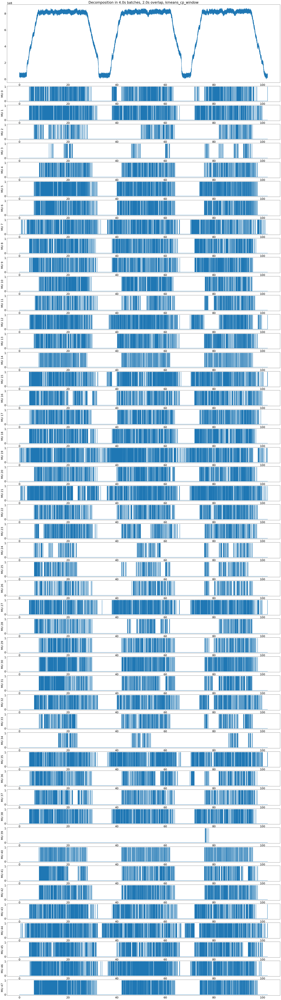

In [30]:
visualize_pt(kmeans_sil_cp_window_40_ol20["MUPulses"], 
             data, ref_signal=ref_signal,
             title=f"Decomposition in {batch_size}s batches, {ol[1]}s overlap, kmeans_cp_window")

### 4.0s, 3.0s overlap

In [50]:
kmeans_sil_cp_window_40_ol30 = batch_decomp_window(data, B_rt, mean_tm, discard = bad_ch, 
                                     use_kmeans=True, thd_noise=0.38, 
                                     classify_mu=True, 
                                     sil_dist=True, 
                                     thd_sil=0.85,
                                     thd_pps=5, 
                                     sc_tm=sc_tm, nc_tm=nc_tm, 
                                     batch_size=batch_size, overlap=ol[2])

In [51]:
roa_kmeans_sil_cp_window_40_ol30 = calc_roa(ind_pt1=kmeans_sil_cp_window_40_ol30["MUPulses"], 
                                    ind_pt2=decomp["MUPulses"], 
                                    data=data, 
                                    decomp=f"kmeans_cp_window {batch_size}s, overlap:{ol[2]}s")

RoA between offline decomposition and kmeans_cp_window 4.0s, overlap:3.0s (%):
Motor unit 0: 47.40820734341253
Motor unit 1: 10.149750415973378
Motor unit 2: 11.349419124218052
Motor unit 3: 11.11111111111111
Motor unit 4: 56.84647302904564
Motor unit 5: 81.50887573964496
Motor unit 6: 65.625
Motor unit 7: 2.7679919476597887
Motor unit 8: 51.58002038735984
Motor unit 9: 40.48821548821549
Motor unit 10: 63.564875491481
Motor unit 11: 3.35195530726257
Motor unit 12: 1.68506682161534
Motor unit 13: 59.73154362416108
Motor unit 14: 70.46413502109705
Motor unit 15: 12.401693889897157
Motor unit 16: 47.19222462203024
Motor unit 17: 20.73394495412844
Motor unit 18: 47.623666343355964
Motor unit 19: 5.306345733041575
Motor unit 20: 29.131886477462437
Motor unit 21: 5.5155875299760195
Motor unit 22: 17.51412429378531
Motor unit 23: 31.228070175438596
Motor unit 24: 22.587268993839835
Motor unit 25: 31.446540880503143
Motor unit 26: 14.142857142857142
Motor unit 27: 7.319587628865979
Motor unit 

In [49]:
def batch_decomp_window(data, B_realtime, mean_tm=None, discard=None, l=31,
                 use_kmeans=False, thd_noise=0.38,
                 classify_mu=True, sil_dist = True,
                 thd_sil=0.9, thd_cent_dist=0.6,
                 thd_pps=5,
                 sc_tm=None, nc_tm=None,
                 batch_size=0.6, overlap=0.3, fs=2048):
    if ((data[0][0].size == 0 or
         data[12][0].size == 0) and data.ndim == 2) or data.ndim == 3:
        end_time = data[0][1].shape[1] / fs
    else:
        end_time = data.shape[1] / fs
    time = 0.0
    while True:
        raw = crop_data(data, start = time, end = time+batch_size)

        # Source extraction
        s, _ = source_extraction(x = raw, 
                                 B_realtime = B_realtime, 
                                 mean_tm = mean_tm,
                                 discard=discard)

        # Peak extraction
        s2, peak_indices = peak_extraction(s=s, l=l)
        
        # Spike classification
        if time == 0.0:
            MUPulses, cls_values, _, _, _ = spike_classification(s2=s2, 
                                                        peak_indices=peak_indices, 
                                                        use_kmeans=use_kmeans, 
                                                        thd_noise=thd_noise,
                                                        classify_mu=classify_mu, 
                                                        sil_dist = sil_dist, 
                                                        thd_sil=thd_sil, 
                                                        thd_cent_dist=thd_cent_dist,
                                                        sc_tm=sc_tm, nc_tm=nc_tm)
            sil_scores = np.tile(cls_values["sil_scores"], (s2.shape[1], 1)).T
            thd_spikes = int(thd_pps * s2.shape[1]/fs)
                
            for i in range(MUPulses.shape[0]):
                # number of spikes in current window
                n_spikes_curr_i = MUPulses[i].shape[0]
                if (n_spikes_curr_i < thd_spikes):
                    MUPulses[i] = np.array([], dtype="int64")
                
            time += batch_size-overlap
        else:
            tmp = []
            MUPulses_curr, cls_values_curr, _, _, _ = spike_classification(s2=s2, 
                                                             peak_indices=peak_indices, 
                                                             use_kmeans=use_kmeans, 
                                                             thd_noise=thd_noise,
                                                             classify_mu=classify_mu, 
                                                             sil_dist = sil_dist, 
                                                             thd_sil=thd_sil, 
                                                             thd_cent_dist=thd_cent_dist,
                                                             sc_tm=sc_tm, nc_tm=nc_tm)
             
            MUPulses_curr = MUPulses_curr + int(time*fs)

            sil_scores_curr = np.tile(cls_values_curr["sil_scores"], (s2.shape[1], 1)).T
            sil_scores_curr = batch_sil(sil_scores, 
                                        sil_scores_curr, 
                                        overlap=overlap, 
                                        fs=fs)
            sil_scores = sil_scores_curr
            thd_spikes = int(thd_pps * s2.shape[1]/fs)

            for i in range(MUPulses.shape[0]):
                # number of spikes in current window
                n_spikes_curr_i = MUPulses_curr[i].shape[0]
                
                if (n_spikes_curr_i >= thd_spikes) and (n_spikes_curr_i >= thd_pps):
                    add_MUPulses = MUPulses_curr[i][MUPulses_curr[i] >= (time+overlap)*fs]
                else:
                    add_MUPulses = np.array([], dtype="int64")
                MUPulses_curr_i = np.append(MUPulses[i], add_MUPulses)
                tmp.append( np.array( MUPulses_curr_i, dtype="int64" ) ) 
            tmp = np.array(tmp, dtype="object")
            MUPulses_curr = tmp
            MUPulses = MUPulses_curr    
            time += batch_size-overlap

        if time >= end_time:
            break

    decomp = {"MUPulses": MUPulses, "sil_scores": sil_scores}
    return decomp

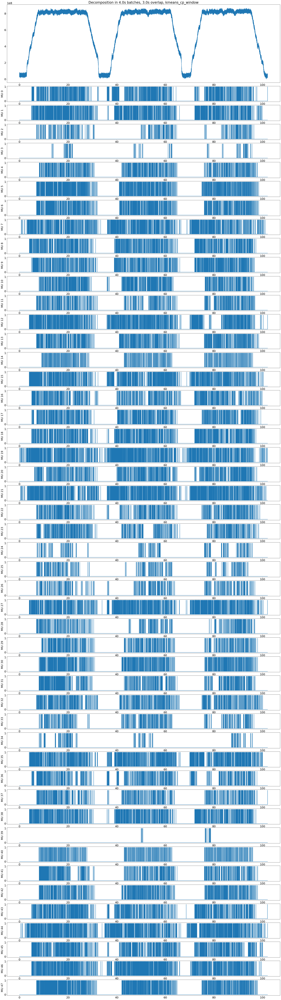

In [52]:
visualize_pt(kmeans_sil_cp_window_40_ol30["MUPulses"], 
             data, ref_signal=ref_signal,
             title=f"Decomposition in {batch_size}s batches, {ol[2]}s overlap, kmeans_cp_window")

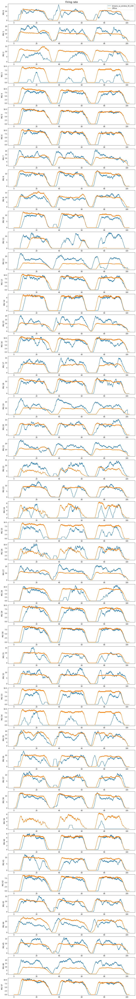

In [57]:
compare_firing_rate(ind_pt1=kmeans_sil_cp_window_40_ol30["MUPulses"], 
                    ind_pt2=decomp["MUPulses"],
                    data=data, time_bin=3.0, filt=False,
                    title="Firing rate",
                    label1="kmeans_cp_window_40_ol30",
                    label2="Offline")